In [1]:
using DifferentialEquations
using LinearAlgebra
using Combinatorics
using SymEngine
using NLsolve
using Plots
using PlotlyJS
using Tullio
using ModelingToolkit
import Statistics
using FastDifferentiation
using Random
# using JLD2
using Symbolics
using ForwardDiff
# using LaTeXStrings

In [2]:
import Statistics

In [3]:
function get_norm(T, g)
    """
    T should have configuration either 'u' or 'uu'
    """
    if ndims(T) == 2
        # @tensor begin
           @tullio D[] := g[u,a]*g[v,b]*T[a,b]*T[u,v]
        # end
        # return ein"(ua,vb,ab),uv->"(g,T,T)
        return D[1]
    else
        # @tensor begin
            @tullio D[] := g[a, b] * T[b] * T[a]
        # end
        # return ein"(ab,b),a->"(g,T,T)
        return D[1]
    end
end

get_norm (generic function with 1 method)

In [4]:
function levi_civita_symbol(dim=4)
    arr = zeros(Int, tuple(fill(dim, dim)...))
    for x in permutations(1:dim)
        mat = zeros(Int, (dim, dim))
        for (i, j) in enumerate(x)
            mat[i, j] = 1
        end
        arr[x...] = det(mat)
    end
    return arr
end

levi_civita_symbol (generic function with 2 methods)

In [5]:
function levi_civita_tensor(gk)
    epsu= levi_civita_symbol()
    det_g= det(gk)
    return epsu/sqrt(-(det_g))
end

levi_civita_tensor (generic function with 1 method)

In [6]:
function cov_metric_tensor(r, theta, a, M=1.0)
    """
    Define the metric tensor function.

    Parameters:
        a (float): Parameter 'a' in the metric.
        r (float): Parameter 'r' in the metric.
        theta (float): Parameter 'theta' in the metric.

    Returns:
        ndarray: The metric tensor at the given values of a, r, and theta/pi.
        Configuration: ll
    """
    #! Correction Added Mass term in the symbols 
    g= zeros(typeof(r),(4,4))

    Delta = a^2 - 2 * M * r + r^2
    Sigma = r^2 + a^2 * cos(theta) ^ 2

    g[1,1]=-(1.0-2.0*M*r/Sigma)
    g[2,2]=Sigma/Delta
    g[3,3]= Sigma
    g[4,4]=sin(theta)^2*((r^2+a^2)^2-Delta*a^2*sin(theta)^2)/Sigma
    g[1,4]=-2.0*a*M*r*sin(theta)^2/Sigma
    g[4,1]=g[1,4]

    return g
end


cov_metric_tensor (generic function with 2 methods)

In [7]:
function cot_metric_tensor(r, theta, a, M=1.0)
    """
    Define the metric tensor function.

    Parameters:
        a (float): Parameter 'a' in the metric.
        r (float): Parameter 'r' in the metric.
        theta (float): Parameter 'theta' in the metric.

    Returns:
        ndarray: The metric tensor at the given values of a, r, and theta.
        Configuration: uu
    """
    Delta = a^2 - 2 * M * r + r^2
    Sigma = r^2 + a^2 * cos(theta) ^ 2

    denom= Delta*sin(theta)^2

    g=zeros(typeof(r),(4,4))
    g[1,1]=-(sin(theta)^2 * ((r^2+a^2)^2- Delta*a^2 * sin(theta)^2)/Sigma)/denom

    g[2,2]=Delta/Sigma

    g[3,3]=1.0/Sigma

    # g[3, 3] = -(-(1.0 - 2.0 * r / Sigma)) / denom
    #! Corrected the g[3,3] term below
    g[4,4]= (Delta-a^2*sin(theta)^2)/(denom*Sigma)

    g[1,4]=(-2.0*a*M*r*sin(theta)^2/Sigma)/denom

    g[4,1]=g[1,4]

    return g
    
end

cot_metric_tensor (generic function with 2 methods)

In [8]:
#! The above function seem correct. I verified them for various values.

In [9]:
function kerr_christoffel(r, theta, a, M=1)
    """
    Function to give the Christoffel symbols for the Kerr metric.
    The Christoffel symbols are given as Gamma ^i _{jk}

    From Reference Paper, Appendix
    Config: ull
    """

    cs = zeros(typeof(r),(4, 4, 4))

    # Definitions
    Delta = a^2 - 2 * M * r + r^2
    Sigma = r^2 + a^2 * cos(theta)^2

    cs[4, 1, 2] = M * (2 * r^2 - Sigma) / (Delta * Sigma^2) * a
    cs[1, 1, 2] = M*(r^2 + a^2) * (r^2 - a^2 * cos(theta)^2) / (Sigma ^ 2 * Delta)

    cs[4, 1, 3] = -2 * M * a * r * (cos(theta)/sin(theta) )/ ( Sigma^2)
    cs[1, 1, 3] = -2*M*a^2*r*sin(theta)*cos(theta)/Sigma^2

    cs[1, 2, 4] = (
        -M
        * a
        * (2 * r^2 * (r^2 + a^2) + Sigma * (r^2 - a^2))
        * sin(theta) ^ 2
        / (Delta * Sigma^2)
    )

    cs[4, 2, 4] = (
        r * Sigma * (Sigma - 2 * M * r)
        - M * a^2 * (2 * r^2 - Sigma) * sin(theta) ^ 2
    ) / (Delta * Sigma^2)

    cs[1, 3, 4] = M * a^3 * r * sin(theta) ^ 2 * sin(2 * theta) / Sigma^2

    cs[4, 3, 4] = (cos(theta)/sin(theta))*(Sigma^2+2*M*a^2*r*sin(theta)^2)/Sigma^2

    cs[2, 1, 1] = M * Delta * (2 * r^2 - Sigma) / Sigma^3

    cs[2, 1, 4] = -cs[2, 1, 1] * a * sin(theta) ^ 2

    cs[3, 1, 1] = -M * a * r * sin(2 * theta) / Sigma^3 * a
    cs[3, 1, 4] = 2.0 *M* r * a * (r^2 + a^2) * sin(theta) * cos(theta) / Sigma^3

    cs[2, 2, 2] = r / Sigma + (M - r) / Delta

    cs[2, 3, 3] = -r * Delta / Sigma
    cs[3, 2, 3] =  -cs[2, 3, 3] / Delta

    cs[2, 2, 3] = cs[3, 3, 3] = -(a^2) * sin(2 * theta) / (2 * Sigma)
    cs[3, 2, 2] = -cs[2, 2, 3] / Delta

    cs[2, 4, 4] = (
        -Delta
        * (r * Sigma^2 - M * a^2 * (2 * r^2 - Sigma) * sin(theta) ^ 2)
        * sin(theta) ^ 2
        / Sigma^3
    )

    cs[3, 4, 4] = (
        -(Delta * Sigma^2 + 2 * M * r * (r^2 + a^2) ^ 2)
        * sin(2 * theta)
        / (2 * Sigma^3)
    )

    #By symmetry. https://mathworld.wolfram.com/ChristoffelSymboloftheSecondKind.html
    cs[1,2,1] = cs[1,1,2]
    cs[1,3,1] = cs[1,1,3]
    cs[1,4,2] = cs[1,2,4]
    cs[1,4,3] = cs[1,3,4]


    cs[2,4,1] = cs[2,1,4]
    cs[2,3,2]  = cs[2,2,3]

    cs[3,4,1] = cs[3,1,4] 
    cs[3,3,2] = cs[3,2,3] 

    cs[4,2,1]=cs[4,1,2]  
    cs[4,3,1]=cs[4,1,3]  
    cs[4,4,2]=cs[4,2,4]  
    cs[4,4,3]=cs[4,3,4]  

    return cs+ zeros((4,4,4))
end


kerr_christoffel (generic function with 2 methods)

In [10]:
#! The above function is also verified 

In [11]:
function kerr_riemann_tensor(r, theta, a, M=1.0, config="ulll")
    # Define variables
    rijkl = zeros(typeof(r),(4, 4, 4, 4))

    # Definitions
    Delta = a^2 - 2 * M * r + r^2
    Sigma = r^2 + a^2 * cos(theta)^2

    rijkl[1, 1, 1, 4] = (
        2.0 * M^2
        * sin(theta) ^ 2
        * a
        * r^2
        * (r^2 - 3.0 * a^2 * cos(theta) ^ 2)
        / Sigma^4
    )
    
    rijkl[1, 1, 2, 3] = (
        -2.0 * M^2
        * (3.0 * r^2 - a^2 * cos(theta) ^ 2)
        * r
        * cos(theta)
        * a^2
        * sin(theta)
        / (Sigma^3 * Delta)
    )
    
    rijkl[1, 2, 1, 2] = (
        M* r
        * (2.0 * (r^2 + a^2) + a^2 * sin(theta) ^ 2)
        * (r^2 - 3.0 * a^2 * cos(theta) ^ 2)
        / (Sigma^3 * Delta)
    )
    
    rijkl[1, 2, 1, 3] = (
        -M* (3.0 * r^2 - a^2 * cos(theta) ^ 2)
        * (3.0 * (r^2 + a^2) - 2 *M * r)
        * a^2
        * sin(theta)
        * cos(theta)
        / (Sigma^3 * Delta)
    )
    
    rijkl[1, 2, 2, 4] = (
        3.0 * M
        * sin(theta) ^ 2
        * a
        * r
        * (r^2 + a^2)
        * (r^2 - 3.0 * a^2 * cos(theta) ^ 2)
        / (Sigma^3 * Delta)
    )

    rijkl[1, 2, 3, 4] = (
        -M * cos(theta)
        * sin(theta)
        * a
        * (3.0 * r^2 - a^2 * cos(theta) ^ 2)
        * (2.0 * (r^2 + a^2) ^ 2 + a^2 * sin(theta) ^ 2 * Delta)
        / (Sigma^3 * Delta)
    )

    #Antisymmetric under exchange of last two indices. 
    rijkl[1,1,4,1] = -rijkl[1,1,1,4]
    rijkl[1,1,3,2] = -rijkl[1,1,2,3]
    rijkl[1,2,2,1] = -rijkl[1,2,1,2]
    rijkl[1,2,3,1] = -rijkl[1,2,1,3] 
    rijkl[1,2,4,2] = -rijkl[1,2,2,4]  
    rijkl[1,2,4,3] = -rijkl[1,2,3,4] 

    #!-------------------------------------------------------------------------------

    rijkl[1, 3, 1, 2] = (
        -M* (3.0 * r^2 - a^2 * cos(theta) ^ 2)
        * (3.0 * (r^2 + a^2) - 4 *M* r)
        * a^2
        * sin(theta)
        * cos(theta)
        / (Sigma^3 * Delta)
    )

    rijkl[1, 3, 1, 3] = (
        -M * r
        * (r^2 - 3.0 * a^2 * cos(theta) ^ 2)
        * (r^2 + a^2 + 2 * a^2 * sin(theta) ^ 2)
        / Sigma^3
    )
    
    rijkl[1, 3, 2, 4] = (
        -M * (3.0 * r^2 - a^2 * cos(theta) ^ 2)
        * ((a^2 + r^2) ^ 2 + 2.0 * a^2 * sin(theta) ^ 2 * Delta)
        * a
        * sin(theta)
        * cos(theta)
        / (Sigma^3 * Delta)
    )

    rijkl[1, 3, 3, 4] = (
        -3.0 * M
        * sin(theta) ^ 2
        * r
        * a
        * (a^2 + r^2)
        * (r^2 - 3.0 * a^2 * cos(theta) ^ 2)
        / Sigma^3
    )

    rijkl[1, 4, 1, 4] = (
        -sin(theta) ^ 2 * M
        * r
        * (r^2 + 3 * a^2 * sin(theta) ^ 2 - 3 * a^2)
        * ((a^2 + r^2) ^ 2 - a^2 * sin(theta) ^ 2 * Delta)
        / Sigma^4
    )

    rijkl[1, 4, 2, 3] = (
        (3.0 * r^2 - a^2 * cos(theta) ^ 2) * M
        * ((a^2 + r^2) ^ 2 - a^2 * sin(theta) ^ 2 * Delta)
        * a
        * sin(theta)
        * cos(theta)
        / (Sigma^3 * Delta)
    )

    #Symmetries
    rijkl[1,3,2,1] = -rijkl[1,3,1,2]
    rijkl[1,3,3,1] = -rijkl[1,3,1,3]
    rijkl[1,3,4,2] = -rijkl[1,3,2,4]
    rijkl[1,3,4,3] = -rijkl[1,3,3,4] 
    rijkl[1,4,4,1] = -rijkl[1,4,1,4]  
    rijkl[1,4,3,2] = -rijkl[1,4,2,3]  

    #!------------------------------------------------------------------------------------
    rijkl[2, 1, 1, 2] = (
        r * M
        * (r^2 - 3.0 * a^2 * cos(theta) ^ 2)
        * (a^2 * sin(theta) ^ 2 + 2.0 * Delta)
        / Sigma^4
    )

    rijkl[2, 1, 1, 3] = (
        -3.0 * M
        * Delta
        * a^2
        * (3.0 * r^2 - a^2 * cos(theta) ^ 2)
        * sin(theta)
        * cos(theta)
        / Sigma^4
    )

    rijkl[2, 1, 2, 4] = (
        r * M
        * a
        * (3.0 * (r^2 + a^2) - 4.0 * M * r)
        * (r^2 - 3.0 * a^2 * cos(theta) ^ 2)
        * sin(theta) ^ 2
        / Sigma^4
    )

    rijkl[2, 1, 3, 4] = (
        -a * M
        * (2.0 * (r^2 + a^2) + a^2 * sin(theta) ^ 2)
        * (3.0 * r^2 - a^2 * cos(theta) ^ 2)
        * Delta
        * cos(theta)
        * sin(theta)
        / Sigma^4
    )

    rijkl[2, 3, 1, 4] = (
        -cos(theta) * M
        * sin(theta)
        * a
        * (3.0 * r^2 - a^2 * cos(theta) ^ 2)
        * Delta
        / Sigma^3
    )

    rijkl[2, 3, 2, 3] = -M* r * (r^2 - 3.0 * a^2 * cos(theta) ^ 2) / Sigma^2

    rijkl[2, 4, 1, 2] = (
        -sin(theta) ^ 2 * M
        * r
        * a
        * (r^2 - 3.0 * a^2 * cos(theta) ^ 2)
        * (3.0 * (r^2 + a^2) - 4.0 * M * r)
        / Sigma^4
    )


    rijkl[2, 4, 1, 3] = (
        a * M
        * (3.0 * r^2 - a^2 * cos(theta) ^ 2)
        * (r^2 + a^2 + 2.0 * a^2 * sin(theta) ^ 2)
        * Delta
        * cos(theta)
        * sin(theta)
        / Sigma^4
    )

    rijkl[2, 4, 2, 4] = (
        -sin(theta) ^ 2 * M
        * r
        * (r^2 - 3.0 * a^2 * cos(theta) ^ 2)
        * ((r^2 + a^2) ^ 2 + 2.0 * a^2 * Delta * sin(theta) ^ 2)
        / Sigma^4
    )


    rijkl[2, 4, 3, 4] = (
        3.0 * M
        * a^2
        * (r^2 + a^2)
        * (3.0 * r^2 - a^2 * cos(theta) ^ 2)
        * Delta
        * cos(theta)
        * sin(theta) ^ 3
        / Sigma^4
    )

    #Symmetries
    rijkl[2,1,2,1] = -rijkl[2,1,1,2]  
    rijkl[2,1,3,1] = -rijkl[2,1,1,3]  
    rijkl[2,1,4,2] = -rijkl[2,1,2,4] 
    rijkl[2,1,4,3] = -rijkl[2,1,3,4] 
    rijkl[2,3,4,1] = -rijkl[2,3,1,4]  
    rijkl[2,3,3,2] = -rijkl[2,3,2,3]  
    rijkl[2,4,2,1] = -rijkl[2,4,1,2]  
    rijkl[2,4,3,1] = -rijkl[2,4,1,3]  
    rijkl[2,4,4,2] = -rijkl[2,4,2,4]  
    rijkl[2,4,4,3] = -rijkl[2,4,3,4]   

    #!----------------------------------------------------------------------------------------

    rijkl[3, 1, 1, 2] = (
        -3.0 * M
        * a^2
        * (3.0 * r^2 - a^2 * cos(theta) ^ 2)
        * sin(theta)
        * cos(theta)
        / Sigma^4
    )

    rijkl[3, 1, 1, 3] = (
        -M * r
        * (r^2 - 3.0 * a^2 * cos(theta) ^ 2)
        * (2.0 * a^2 * sin(theta) ^ 2 + Delta)
        / Sigma^4
    )

    rijkl[3, 1, 2, 4] = (
        -a * M
        * (3.0 * r^2 - a^2 * cos(theta) ^ 2)
        * (r^2 + a^2 + 2.0 * a^2 * sin(theta) ^ 2)
        * cos(theta)
        * sin(theta)
        / Sigma^4
    )

    rijkl[3, 1, 3, 4] = (
        -M * r
        * a
        * (r^2 - 3.0 * a^2 * cos(theta) ^ 2)
        * (3.0 * (r^2 + a^2) - 2.0 * M * r)
        * sin(theta) ^ 2
        / Sigma^4
    )

    rijkl[3, 2, 1, 4] = (
        M * a * (3.0 * r^2 - a^2 * cos(theta) ^ 2) * cos(theta) * sin(theta) / Sigma^3
    )

    rijkl[3, 2, 2, 3] = M * r * (r^2 - 3.0 * a^2 * cos(theta) ^ 2) / (Delta * Sigma^2)

    rijkl[3, 4, 1, 2] = (
        M * a
        * (2.0 * (r^2 + a^2) + a^2 * sin(theta) ^ 2)
        * (3.0 * r^2 - a^2 * cos(theta) ^ 2)
        * cos(theta)
        * sin(theta)
        / Sigma^4
    )

    rijkl[3, 4, 1, 3] = (
        M * r
        * a
        * (r^2 - 3.0 * a^2 * cos(theta) ^ 2)
        * (3.0 * (r^2 + a^2) - 2.0 * M * r)
        * sin(theta) ^ 2
        / Sigma^4
    )



    rijkl[3, 4, 2, 4] = (
        3.0 * M
        * a^2
        * (r^2 + a^2)
        * (3.0 * r^2 - a^2 * cos(theta) ^ 2)
        * cos(theta)
        * sin(theta) ^ 3
        / Sigma^4
    )

    rijkl[3, 4, 3, 4] = (
        M * r
        * (r^2 - 3.0 * a^2 * cos(theta) ^ 2)
        * (2.0 * (r^2 + a^2) ^ 2 + a^2 * Delta * sin(theta) ^ 2)
        * sin(theta) ^ 2
        / Sigma^4
    )

    #Symmetries
    rijkl[3,1,2,1] = -rijkl[3,1,1,2]  
    rijkl[3,1,3,1] = -rijkl[3,1,1,3]  
    rijkl[3,1,4,2] = -rijkl[3,1,2,4] 
    rijkl[3,1,4,3] = -rijkl[3,1,3,4] 
    rijkl[3,2,4,1] = -rijkl[3,2,1,4]  
    rijkl[3,2,3,2] = -rijkl[3,2,2,3]  
    rijkl[3,4,2,1] = -rijkl[3,4,1,2]  
    rijkl[3,4,3,1] = -rijkl[3,4,1,3]  
    rijkl[3,4,4,2] = -rijkl[3,4,2,4]  
    rijkl[3,4,4,3] = -rijkl[3,4,3,4]  

    #!-----------------------------------------------------------------------------


    rijkl[4, 1, 2, 3] = (
        -M * (3.0 * r^2 - a^2 * cos(theta) ^ 2) * (a^2 * sin(theta) ^ 2 - Delta)
        * a * (cos(theta) / sin(theta))
        / (Delta * Sigma^3)
    )

    rijkl[4, 2, 1, 2] = (
        3.0 * M * r * a * (r^2 - 3.0 * a^2 * cos(theta) ^ 2)
        / (Delta * Sigma^3)
    )

    rijkl[4, 2, 1, 3] = (
        -M * a * (3.0 * r^2 - a^2 * cos(theta) ^ 2) * (2.0 * a^2 * sin(theta) ^ 2 + Delta)
        * (cos(theta) / sin(theta))
        / (Delta * Sigma^3)
    )

    rijkl[4, 2, 2, 4] = (
        M * r * (r^2 - 3.0 * a^2 * cos(theta) ^ 2) * (r^2 + a^2 + 2.0 * a^2 * sin(theta) ^ 2)
        / (Delta * Sigma^3)
    )

    rijkl[4, 2, 3, 4] = (
        -M * (3.0 * r^2 - a^2 * cos(theta) ^ 2) * (3.0 * (r^2 + a^2) - 2.0 * M * r) * a^2 * sin(theta) * cos(theta)
        / (Delta * Sigma^3)
        )
        
    rijkl[4, 3, 1, 2] = (
        -M * (3.0 * r^2 - a^2 * cos(theta) ^ 2) * (a^2 * sin(theta) ^ 2 + 2.0 * Delta)
        * a * (cos(theta) / sin(theta))
        / (Delta * Sigma^3)
    )

    rijkl[4, 3, 1, 3] = (
        -M * 3.0 * r * a * (r^2 - 3.0 * a^2 * cos(theta) ^ 2)
        / Sigma^3
    )

    rijkl[4, 3, 2, 4] = (
        -M * a^2 * (3 * r^2 - a^2 * cos(theta) ^ 2) * (3.0 * (r^2 + a^2) - 4.0 * M * r) * sin(theta) * cos(theta)
        / (Delta * Sigma^3)
    )

    rijkl[4, 3, 3, 4] = (
        -M * r * (2.0 * (r^2 + a^2) + a^2 * sin(theta) ^ 2) * (r^2 - 3.0 * a^2 * cos(theta) ^ 2)
        / Sigma^3
    )
    
    rijkl[4, 4, 1, 4] = (
        -2.0 * M^2 * a * r^2 * (r^2 - 3.0 * a^2 * cos(theta) ^ 2) * sin(theta) ^ 2
        / Sigma^4
    )

    rijkl[4, 4, 2, 3] = (
        2.0 * M^2 * r * a^2 * (3.0 * r^2 - a^2 * cos(theta) ^ 2) * cos(theta) * sin(theta)
        / (Delta * Sigma^3)
    )

    #Symmetries
    rijkl[4,1,3,2] = -rijkl[4,1,2,3]  
    rijkl[4,2,2,1] = -rijkl[4,2,1,2]  
    rijkl[4,2,3,1] = -rijkl[4,2,1,3] 
    rijkl[4,2,4,2] = -rijkl[4,2,2,4] 
    rijkl[4,2,4,3] = -rijkl[4,2,3,4]  
    rijkl[4,3,2,1] = -rijkl[4,3,1,2]  
    rijkl[4,3,3,1] = -rijkl[4,3,1,3]  
    rijkl[4,3,4,2] = -rijkl[4,3,2,4]  
    rijkl[4,3,4,3] = -rijkl[4,3,3,4]  
    rijkl[4,4,4,1] = -rijkl[4,4,1,4]   
    rijkl[4,4,3,2] = -rijkl[4,4,2,3]
    
    
    #!-----------------------------------------------------------------------------------

    part1= a^2 + 2*r*(-2*M +r) +a^2*cos(2*theta)
    part2= 3*a^2 -2*r^2 +3*a^2*cos(2*theta)
    part3= (a^2+ 2* r^2+ a^2*cos(2*theta))^4
    # Calculating Rtensor elements

    # rijkl[3, 0, 0, 3] =  (part1 + part2 + part3 + part4) / (Sigma^5)
    rijkl[4,1,1,4]= 4*M*r*part1*part2/part3
    rijkl[4, 1, 4, 1] = -rijkl[4, 1, 1, 4]

    if config == "ulll"
        return rijkl + zeros(typeof(r), (4, 4, 4, 4))

    elseif config == "llll"
        gk=cov_metric_tensor(r,theta,a,M)
        # return ein"ij,jklm->iklm"(gk, rijkl)
        # @tensor begin
           @tullio G[i,k,l,m] := gk[i,j]*rijkl[j,k,l,m]
        # end
        return G+zeros(typeof(r),(4, 4, 4, 4))


    else
        return "Invalid String"
    end
end


kerr_riemann_tensor (generic function with 3 methods)

In [12]:
function spintensor(levi, pvector, svector, gk, m)
    # @tensor begin
     @tullio   p_vectorl[i] := gk[i, j] * pvector[j]
    # end

    # @tensor begin
     @tullio   s_vectorl[i] := gk[i, j] * svector[j]
    # end

    # @tensor begin
     @tullio   ret[u, v] := levi[u, v, a, b] * p_vectorl[a] * s_vectorl[b] / m
    # end
    return ret

end

spintensor (generic function with 1 method)

In [13]:
function metric_D(r, theta, a, M=1.0)
    dgkp = zeros(typeof(r), (4, 4))
    dgkt = zeros(typeof(r), (4, 4))

    denom = (r^2 + a^2 * cos(theta)^2)^2

    dgkt[2, 1] = M * (a^2 - 2 * r^2 + a^2 * cos(2 * theta)) / denom

    dgkt[2, 4] = -(2 * a * M * (-r^2 + a^2 * cos(theta)^2) * sin(theta)^2) / denom
    dgkt[3, 1] = 2 * a^2 * M * r * sin(2 * theta) / denom
    dgkt[3, 4] = -2 * a * M * r * (r^2 + a^2) * sin(2 * theta) / denom

    dgkp[2, 1] = -2 * a * M * (-r^2 + a^2 * cos(theta)^2) * sin(theta)^2 / denom
    dgkp[2, 4] = 2 * sin(theta)^2 * (cos(theta)^2 * (2 * a^2 * r * (a^2 + r^2) + a^4 * (M - r) * sin(theta)^2) + r * (-a^4 + r^4 + a^2 * (a^2 - M * r) * sin(theta)^2)) / denom
    dgkp[3, 1] = -2 * a * M * r * (a^2 + r^2) * sin(2 * theta) / denom
    dgkp[3, 4] = (3 * a^6 + 10 * a^4 * M * r + 11 * a^4 * r^2 + 16 * a^2 * M * r^3 + 16 * a^2 * r^4 + 8 * r^6 + 4 * a^2 * (a^2 + 2 * r^2) * (a^2 + r * (-2 * M + r)) * cos(2 * theta) + a^4 * (a^2 - 2 * M * r + r^2) * cos(4 * theta)) * sin(2 * theta) / (8 * denom)

    return transpose(dgkt) .+ zeros(Float64, (4, 4)), transpose(dgkp) .+ zeros(Float64, (4, 4))

end

metric_D (generic function with 2 methods)

In [14]:
function energy(gk, pvector, Stensor, dgkt)
    # @tensor begin
     @tullio   pvecl[i] := gk[i, j] * pvector[j]
    # end
    # @tensor begin
      @tullio  term2[] := dgkt[u, v] * Stensor[u, v] / 2.0
    # end

    return -pvecl[1] + term2[1]

end

energy (generic function with 1 method)

In [15]:
function angular_momentum(gk, pvector, Stensor, dgkp)
    # @tensor begin
     @tullio   pvecl[i] := gk[i, j] * pvector[j]

    # end
    # @tensor begin
      @tullio  term2[] := dgkp[u, v] * Stensor[u, v] / 2.0

    # end

    return pvecl[4] - term2[1]

end

angular_momentum (generic function with 1 method)

In [16]:

function spin_matrix(sa, pb, epsilon, gk, m)
    # Resultant Config: aa
    # Input Config: u,u,uu,llll
    # In Tetrad Basis or Coordinate basis
    # gkinv = inv(gk)
    # return ein"(ab,cd,bdkl,l),k -> ac"(gkinv, gkinv, epsilon, sa, pb)
    # @tensor begin
    @tullio    E[b,d] := epsilon[b,d,k,l]*gk[k,x]*pb[x]*gk[l,y]*sa[y]/m
    # end
    return E
end


spin_matrix (generic function with 1 method)

In [17]:
function to_cartesian(rsol)
    r, t, p = rsol[2], rsol[3], rsol[4]
    vr,vt,vp= rsol[5],rsol[6],rsol[7]

    x = r .* sin(t) .* cos(p)
    y = r .* sin(t) .* sin(p)
    z = r .* cos(t)

    vx = vr .* sin(vt) .* cos(vp)
    vy = vr .* sin(vt) .* sin(vp)
    vz=vr.*cos(vt)

    return hcat(x, y, z),hcat(vx,vy,vz)
end


to_cartesian (generic function with 1 method)

In [18]:
function calculate_four_momentum(pvector, uvector, svector, cs, Riemann, levi_mixed, m0)

    @tullio correction[α] := (Riemann[α, β, ρ, σ] * levi_mixed[ρ, σ, μ, ν] * uvector[β] * svector[μ] * pvector[ν]) / (2.0 * m0)

    @tullio dp[α] := -cs[α, μ, ν] * pvector[μ] * uvector[ν]

    dp = dp .+ correction

    return dp
end

calculate_four_momentum (generic function with 1 method)

In [19]:
function rhs23(vmu, su, ps, cs, rulll, epsilon_mixed, m)

    # @tensor begin
      @tullio  term1[u] := rulll[u,v,a,b]*epsilon_mixed[a,b,p,s]*vmu[v]*su[p]*ps[s]/(2.0*m) 
    # end


    # @tensor begin
      @tullio  term2[u] := cs[u,s,p]*ps[s]*vmu[p]
    # end

    return term1 - term2
end


rhs23 (generic function with 1 method)

In [20]:
function calculate_four_spin(pvector, uvector, svector, cs, Riemann_covar, levi_mixed, m0)

    @tullio correction[α] := pvector[α] * (Riemann_covar[γ, β, ρ, σ] * levi_mixed[ρ, σ, μ, ν] * svector[γ] * uvector[β] * svector[μ] * pvector[ν]) / (2.0 * m0^3)

    @tullio ds[α] := -cs[α, μ, ν] * svector[μ] * uvector[ν] 

    ds = ds .+ correction

    return ds
end

calculate_four_spin (generic function with 1 method)

In [21]:
function rhs24(vmu, su, ps, cs, rllll, epsilon_mixed, m)

    # @tensor begin
     @tullio   term1[a] := ps[a]*rllll[g,b,p,s]*epsilon_mixed[p,s,u,v]*su[g]*vmu[b]*su[u]*ps[v]/(2.0*m^3)
    # end

    # @tensor begin
     @tullio   term2[u] := cs[u,s,p]*su[s]*vmu[p]
    # end

    return term1 - term2
end


rhs24 (generic function with 1 method)

In [22]:
function calculate_four_velocity(pvector, Stensor, Riemann_cov, m0)

    @tullio scalar_divisor := Riemann_cov[μ, ν, ρ, σ] * Stensor[μ, ν] * Stensor[ρ, σ] / 4.0

    @tullio correction[α] := (Stensor[α, β] * Riemann_cov[β, γ, μ, ν] * pvector[γ] * Stensor[μ, ν]) 

    correction = correction ./ (2.0 * (m0^2 + scalar_divisor))

    dx= (pvector .+ correction) / m0

    # @tullio Vsq := g[μ, ν] * dx[μ] * dx[ν]

    # PV = -sqrt(-1 / Vsq)
    PV= 1.0
    dx = dx * PV

    return dx
end


calculate_four_velocity (generic function with 1 method)

In [23]:
function rhs27(umu, Stensor, rllll, m)

    # @tensor begin
      @tullio  delta[]:= rllll[a,b,g,s]*Stensor[a,b]*Stensor[g,s]/4.0
    # end

    # @tensor begin
      @tullio  num[u]:= Stensor[u,v]*rllll[v,l,p,s]*umu[l]*Stensor[p,s]
    # end

    correction= num /(2.0*(m^2+delta[1]))

    dx= umu + correction

    return dx

end


rhs27 (generic function with 1 method)

In [24]:
function MPD!(du, u, p, τ)

    #Extract the coordinates/constants 
    t, r, theta, ϕ, pᵗ, pʳ, pᶿ, pᵠ, sᵗ, sʳ, sᶿ, sᵠ = u # coordinate variables
    a, m, M = p                            # constants
    #Define vectors from the coordinate variables. 
    # xvector = [t, r, theta, ϕ]
    pvector = u[5:8]
    svector = u[9:end]


    # # #Define some useful quantities for this timestep 
    gk = cov_metric_tensor(r, theta, a, M)        # the metric 
    cs = kerr_christoffel(r, theta, a, M)            # the Christoffel symbols
    Riemann = kerr_riemann_tensor(r, theta, a, M, "ulll")          #the mixed contra/covar Riemann term R^{a}_{bcd}
    levi = levi_civita_tensor(gk)  #This is the fully contravariant Levi Civita tensor 

    # @tensor begin
      @tullio  levi_mixed[ρ, σ, μ, ν] := levi[ρ, σ, x, y] * gk[x, μ] * gk[y, ν]
    # end

    # @tensor begin
      @tullio  Riemann_cov[μ, ν, ρ, σ] := gk[μ, λ] * Riemann[λ, ν, ρ, σ] #This is the fully covariant form R_{abcd}
    # end

    stensor = spintensor(levi, pvector, svector, gk, m) #the fully contravariant spin tensor s^{ab}

    # Get the derivative objects
    # 4-velocity
    uvector = calculate_four_velocity(pvector, stensor, Riemann_cov, m)

    # 4-momentum
    dp = calculate_four_momentum(pvector, uvector, svector, cs, Riemann, levi_mixed, m)

    # 4-spin
    ds = calculate_four_spin(pvector, uvector, svector, cs, Riemann_cov, levi_mixed, m)

    du[1:4] .= uvector
    du[5:8] .= dp
    du[9:end] .= ds

    nothing #function returns nothing
    # return du


end

MPD! (generic function with 1 method)

In [25]:
function mpdjac(u, p, τ)

    du= zeros(typeof(u[1]),12)
    #Extract the coordinates/constants 
    t, r, theta, ϕ, pᵗ, pʳ, pᶿ, pᵠ, sᵗ, sʳ, sᶿ, sᵠ = u # coordinate variables
    a, m, M = p                            # constants
    #Define vectors from the coordinate variables. 
    # xvector = [t, r, theta, ϕ]
    pvector = u[5:8]
    svector = u[9:end]


    # # #Define some useful quantities for this timestep 
    gk = cov_metric_tensor(r, theta, a, M)        # the metric 
    cs = kerr_christoffel(r, theta, a, M)            # the Christoffel symbols
    Riemann = kerr_riemann_tensor(r, theta, a, M, "ulll")          #the mixed contra/covar Riemann term R^{a}_{bcd}
    levi = levi_civita_tensor(gk)  #This is the fully contravariant Levi Civita tensor 

    # @tensor begin
    @tullio levi_mixed[ρ, σ, μ, ν] := levi[ρ, σ, x, y] * gk[x, μ] * gk[y, ν]
    # end

    # @tensor begin
    @tullio Riemann_cov[μ, ν, ρ, σ] := gk[μ, λ] * Riemann[λ, ν, ρ, σ] #This is the fully covariant form R_{abcd}
    # end

    stensor = spintensor(levi, pvector, svector, gk, m) #the fully contravariant spin tensor s^{ab}

    # Get the derivative objects
    # 4-velocity
    uvector = calculate_four_velocity(pvector, stensor, Riemann_cov, m)

    # 4-momentum
    dp = calculate_four_momentum(pvector, uvector, svector, cs, Riemann, levi_mixed, m)

    # 4-spin
    ds = calculate_four_spin(pvector, uvector, svector, cs, Riemann_cov, levi_mixed, m)

    du[1:4] .= uvector
    du[5:8] .= dp
    du[9:end] .= ds

    # nothing #function returns nothing
    return du


end

mpdjac (generic function with 1 method)

In [26]:
function Jacobian_MPD(u)

    #Extract the coordinates/constants 
    t, r, theta, ϕ, pᵗ, pʳ, pᶿ, pᵠ, sᵗ, sʳ, sᶿ, sᵠ = u[1:12] # coordinate variables
    a, m, M = p                           # constants
    #Define vectors from the coordinate variables. 
    # xvector = [t, r, theta, ϕ]
    pvector = u[5:8]
    svector = u[9:12]


    # # #Define some useful quantities for this timestep 
    gk = cov_metric_tensor(r, theta, a, M)        # the metric 
    cs = kerr_christoffel(r, theta, a, M)            # the Christoffel symbols
    Riemann = kerr_riemann_tensor(r, theta, a, M, "ulll")          #the mixed contra/covar Riemann term R^{a}_{bcd}
    levi = levi_civita_tensor(gk)  #This is the fully contravariant Levi Civita tensor 

    # @tensor begin
    @tullio levi_mixed[ρ, σ, μ, ν] := levi[ρ, σ, x, y] * gk[x, μ] * gk[y, ν]
    # end

    # @tensor begin
    @tullio Riemann_cov[μ, ν, ρ, σ] := gk[μ, λ] * Riemann[λ, ν, ρ, σ] #This is the fully covariant form R_{abcd}
    # end

    stensor = spintensor(levi, pvector, svector, gk, m) #the fully contravariant spin tensor s^{ab}

    # Get the derivative objects
    # 4-velocity
    uvector = calculate_four_velocity(pvector, stensor, Riemann_cov, m)

    # 4-momentum
    dp = calculate_four_momentum(pvector, uvector, svector, cs, Riemann, levi_mixed, m)

    # 4-spin
    ds = calculate_four_spin(pvector, uvector, svector, cs, Riemann_cov, levi_mixed, m)

    # du= zeros(12)
    # du[1:4] .= uvector
    # du[5:8] .= dp
    # du[9:end] .= ds

    # nothing #function returns nothing
    return [uvector;dp;ds]


end

Jacobian_MPD (generic function with 1 method)

In [27]:
function mpd!(dy, y, p, t)
    """
    Solve the MPD Equations Given the Initial Conditions
    """
    a, m, M = p

    ps = y[5:8]
    su = y[9:end]


    gk = cov_metric_tensor(y[2], y[3], a, M)
    cs = kerr_christoffel(y[2], y[3], a,M)  #! G^i_{jk}

    levi = levi_civita_tensor(gk)
    # levi_mixed = np.einsum("psab,au,bv->psuv", levi, gk, gk)
    # @tensor begin
     @tullio   levi_mixed[p,s,u,v] := levi[p,s,x,y]*gk[x,u]*gk[y,v]
    # end

    rulll = kerr_riemann_tensor(y[2], y[3], a, M, "ulll")
    # rllll = np.einsum("ij,jvps->ivps", gk, rulll)
    # @tensor begin
      @tullio  rllll[u,v,p,s]:= gk[u,l]*rulll[l,v,p,s]
    # end

    Stensor = spintensor(levi, ps, su, gk, m)

    vmu = rhs27(ps / m, Stensor, rllll, m)

    dp = rhs23(vmu, su, ps, cs, rulll, levi_mixed, m)

    ds = rhs24(vmu, su, ps, cs, rllll, levi_mixed, m)

    dy[1:4] .= vmu

    dy[5:8] .= dp
    dy[9:end] .= ds

    # return nothing
    
end

mpd! (generic function with 1 method)

In [28]:
M = 1e0
m = 1e0

S = 1.0 * m * M
E = 0.9328 * m
Jz = 2.8 * m * M

r0 = 6.0 * M
theta0 = pi/ 3.0 # In the units of pi
phi0 = 0.0
a0 = 0.8*M

S1 = 0.0
S3 = 0.0

P2 = 0.0

0.0

In [29]:
gk=cov_metric_tensor(r0,theta0,a0,M)

4×4 Matrix{Float64}:
 -0.668142  0.0       0.0   -0.199115
  0.0       1.46753   0.0    0.0
  0.0       0.0      36.16   0.0
 -0.199115  0.0       0.0   27.5995

In [30]:
gkinv = cot_metric_tensor(r0, theta0, a0, M)

4×4 Matrix{Float64}:
 -1.49348    0.0       0.0        -0.0107746
  0.0        0.681416  0.0         0.0
  0.0        0.0       0.0276549   0.0
 -0.0107746  0.0       0.0         0.0361548

In [31]:
cs=kerr_christoffel(r0,theta0,a0,M);

In [32]:
rllll = kerr_riemann_tensor(r0, theta0, a0, M, "llll")
rulll = kerr_riemann_tensor(r0, theta0, a0, M, "ulll")

4×4×4×4 Array{Float64, 4}:
[:, :, 1, 1] =
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0

[:, :, 2, 1] =
  0.0         -0.0134933    0.00220409   0.0
 -0.00620284   0.0          0.0          0.00642623
  5.24406e-5   0.0          0.0         -0.00161168
  0.0         -0.000439045  0.00212747   0.0

[:, :, 3, 1] =
 0.0         0.00251192  0.169483    0.0
 0.00129214  0.0         0.0        -0.0202435
 0.00319117  0.0         0.0        -0.00732374
 0.0         0.00109452  0.0108181   0.0

[:, :, 4, 1] =
 -0.000897518   0.0          0.0        0.124406
  0.0           0.0          0.0194682  0.0
  0.0          -0.000790106  0.0        0.0
  0.00301167    0.0          0.0        0.000897518

[:, :, 1, 2] =
  0.0         0.0134933    -0.00220409   0.0
  0.00620284  0.0           0.0         -0.00642623
 -5.24406e-5  0.0           0.0          0.00161168
  0.0         0.000439045  -0.00212747   0.0

[:, :, 2, 2] =
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0

In [33]:
@vars p0 p1 p3

(p0, p1, p3)

In [34]:
p_coordu = [p0, p1, P2, p3]

4-element Vector{Basic}:
  p0
  p1
 0.0
  p3

In [35]:
s_coordu = [0.0, S1, S / sqrt(gk[3, 3]), S3]

4-element Vector{Float64}:
 0.0
 0.0
 0.16629752630943484
 0.0

In [36]:
get_norm(s_coordu, gk)

1.0000000000000002

In [37]:
# @tensor begin
  @tullio  cseqn[]:=gk[i,j]*p_coordu[j]*s_coordu[i]
# end

0-dimensional Array{Basic, 0}:
0

In [38]:
# Definitions
Delta = a0^2 - 2 * M * r0 + r0^2
Sigma = r0^2 + a0^2 * cos(theta0)^2

36.16

In [39]:
levi = levi_civita_tensor(gk)
#!epsilon^{uuuu}

4×4×4×4 Array{Float64, 4}:
[:, :, 1, 1] =
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0

[:, :, 2, 1] =
 0.0  0.0  0.0         0.0
 0.0  0.0  0.0         0.0
 0.0  0.0  0.0        -0.0319331
 0.0  0.0  0.0319331   0.0

[:, :, 3, 1] =
 0.0   0.0        0.0  0.0
 0.0   0.0        0.0  0.0319331
 0.0   0.0        0.0  0.0
 0.0  -0.0319331  0.0  0.0

[:, :, 4, 1] =
 0.0  0.0         0.0        0.0
 0.0  0.0        -0.0319331  0.0
 0.0  0.0319331   0.0        0.0
 0.0  0.0         0.0        0.0

[:, :, 1, 2] =
 0.0  0.0   0.0        0.0
 0.0  0.0   0.0        0.0
 0.0  0.0   0.0        0.0319331
 0.0  0.0  -0.0319331  0.0

[:, :, 2, 2] =
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0

[:, :, 3, 2] =
 0.0        0.0  0.0  -0.0319331
 0.0        0.0  0.0   0.0
 0.0        0.0  0.0   0.0
 0.0319331  0.0  0.0   0.0

[:, :, 4, 2] =
  0.0        0.0  0.0319331  0.0
  0.0        0.0  0.0        0.0
 -0.0319331  0.0  0.0        0.0

In [40]:
Suv = spintensor(levi, p_coordu, s_coordu, gk, m)
#! S^{mu nu}

4×4 Matrix{Basic}:
                                                               0  …                                               0.281801224378605*p1
 0.192023843160642*(-0.199115044247788*p0 + 27.5994690265487*p3)     -0.192023843160642*(-0.668141592920354*p0 - 0.199115044247788*p3)
                                                               0                                                                     0
                                           -0.281801224378605*p1                                                                     0

In [41]:
dgkt, dgkp = metric_D(r0, theta0, a0, M);
#! dg_{t mu nu},dg_{phi mu nu}

([0.0 -0.05482026783616572 0.005086686920184269 0.0; 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0; 0.0 0.03289216070169944 -0.23297026094443954 0.0], [0.0 0.03289216070169944 -0.23297026094443954 0.0; 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0; 0.0 8.980264703578982 32.00890390050391 0.0])

In [42]:
eq210a = energy(gk, p_coordu, Suv, dgkt) - E;

In [43]:
ModelingToolkit.expand(eq210a)

-0.9328 - 0.996841960446101*(-0.668141592920354*p0 - 0.199115044247788*p3) + 0.00526339925649814*(-0.199115044247788*p0 + 27.5994690265487*p3)

In [44]:
eq210b = angular_momentum(gk, p_coordu, Suv, dgkp) - Jz;

In [45]:
ModelingToolkit.expand(eq210b)

-2.8 - 0.199115044247788*p0 + 27.5994690265487*p3 - (0.862212470490551*(-0.668141592920354*p0 - 0.199115044247788*p3) - 0.00315803955389889*(-0.199115044247788*p0 + 27.5994690265487*p3))

In [46]:
eq533=get_norm(p_coordu,gk)[1]+m^2;

In [47]:
ModelingToolkit.expand(eq533)

1.0 - 0.398230088495575*p0*p3 - 0.668141592920354*p0^2 + 1.46753246753247*p1^2 + 27.5994690265487*p3^2

In [48]:
feq533=lambdify(eq533,[p0,p1,p3])

#36 (generic function with 1 method)

In [49]:
feq210a = lambdify(eq210a, [p0, p1, p3])
feq210b = lambdify(eq210b, [p0, p1, p3])

#36 (generic function with 1 method)

In [50]:
function solve_eq(p)
    [feq210a(p[1],p[2],p[3]),
        feq210b(p[1], p[2], p[3]),
        feq533(p[1], p[2], p[3])]
    
end

solve_eq (generic function with 1 method)

In [51]:
solve_eq([m,m,m])

3-element Vector{Float64}:
  0.07593680918281162
 25.434644871649898
 29.000629812665213

In [52]:
sol=nlsolve(solve_eq,[m,m,m],ftol=1e-12,iterations=1000000)

Results of Nonlinear Solver Algorithm
 * Algorithm: Trust-region with dogleg and autoscaling
 * Starting Point: [1.0, 1.0, 1.0]
 * Zero: [1.360284235878376, 0.25392504008929967, 0.0821326191374528]
 * Inf-norm of residuals: 0.000000
 * Iterations: 9
 * Convergence: true
   * |x - x'| < 0.0e+00: false
   * |f(x)| < 1.0e-12: true
 * Function Calls (f): 10
 * Jacobian Calls (df/dx): 9

In [53]:
sol.zero

3-element Vector{Float64}:
 1.360284235878376
 0.25392504008929967
 0.0821326191374528

In [54]:
feq210b(sol.zero...)

-5.551115123125783e-17

In [55]:
# function co_tat(r, theta, a, vec, method="to")
#     # Definitions
#     Delta = a^2 - 2 * M * r + r^2
#     scA = (r^2 + a^2)^2 - Delta * a^2 * sinpi(theta/pi)^2
#     omega_k = 2 * M * a * r / scA
#     Sigma = r^2 + a^2 * cospi(theta/pi)^2

#     e0 = [sqrt(Delta / Sigma), 0.0, 0.0, -a * sinpi(theta/pi)^2 * sqrt(Delta / Sigma)]

#     e1 = [0.0, sqrt(Sigma / Delta), 0.0, 0.0]
#     e2 = [0.0, 0.0, sqrt(Sigma), 0.0]
#     e3 = [-a * sinpi(theta/pi) / sqrt(Sigma), 0.0, 0.0, (r^2 + a^2) * sinpi(theta/pi) / sqrt(Sigma)]

#     tet = hcat(e0, e1, e2, e3)

#     # Now for tetrad to Coordinate basis
#     tet_inv = inv(tet)

#     if method == "to"
#         if ndims(vec) == 1
#             # return ein"ij,i->j"(tet , vec)
#             @tensor begin
#                 E[j]:=tet[i,j]*vec[i]
#             end
#             return E
#         else
#             # return ein"ij,kl,ik->jl"(tet, tet , vec)
#             @tensor begin
#                 E[j,l]:=tet[i,j]*tet[k,l]*vec[i,k]
#             end
#             return E
#         end
#     elseif method == "from"
#         if ndims(vec) == 1
#             # return ein"ij,i->j"(tet_inv , vec)
#             @tensor begin
#                 E[j]:=tet_inv[i,j]*vec[i]
#             end
#         else
#             # return ein"ij,kl,ik->jl"(tet_inv , tet_inv , vec)
#             @tensor begin
#                 E[j,l]:=tet_inv[i,j]*tet_inv[k,l]*vec[i,k]
#             end
#             return E
#         end
#     end
# end


In [56]:
np_coordu=[sol.zero[1],sol.zero[2],0.,sol.zero[3]]

4-element Vector{Float64}:
 1.360284235878376
 0.25392504008929967
 0.0
 0.0821326191374528

In [57]:
ns_coordu= [0.,S1,S/sqrt(gk[3,3]),S3]

4-element Vector{Float64}:
 0.0
 0.0
 0.16629752630943484
 0.0

In [58]:
get_norm(np_coordu, gk)

-0.9999999999999996

In [59]:
levi = levi_civita_tensor(gk)

4×4×4×4 Array{Float64, 4}:
[:, :, 1, 1] =
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0

[:, :, 2, 1] =
 0.0  0.0  0.0         0.0
 0.0  0.0  0.0         0.0
 0.0  0.0  0.0        -0.0319331
 0.0  0.0  0.0319331   0.0

[:, :, 3, 1] =
 0.0   0.0        0.0  0.0
 0.0   0.0        0.0  0.0319331
 0.0   0.0        0.0  0.0
 0.0  -0.0319331  0.0  0.0

[:, :, 4, 1] =
 0.0  0.0         0.0        0.0
 0.0  0.0        -0.0319331  0.0
 0.0  0.0319331   0.0        0.0
 0.0  0.0         0.0        0.0

[:, :, 1, 2] =
 0.0  0.0   0.0        0.0
 0.0  0.0   0.0        0.0
 0.0  0.0   0.0        0.0319331
 0.0  0.0  -0.0319331  0.0

[:, :, 2, 2] =
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0

[:, :, 3, 2] =
 0.0        0.0  0.0  -0.0319331
 0.0        0.0  0.0   0.0
 0.0        0.0  0.0   0.0
 0.0319331  0.0  0.0   0.0

[:, :, 4, 2] =
  0.0        0.0  0.0319331  0.0
  0.0        0.0  0.0        0.0
 -0.0319331  0.0  0.0        0.0

In [60]:
Suv = spintensor(levi, np_coordu, ns_coordu, gk, m)

4×4 Matrix{Float64}:
  0.0        -0.383273  0.0  0.0715564
  0.383273    0.0       0.0  0.177664
  0.0         0.0       0.0  0.0
 -0.0715564  -0.177664  0.0  0.0

In [61]:
angular_momentum(gk, np_coordu, Suv, dgkp)

2.8

In [62]:
vmu0 = rhs27(np_coordu / m, Suv, rllll, m)

4-element Vector{Float64}:
 1.3621336264749888
 0.25418935257802994
 0.0
 0.08294054573237034

In [63]:
# @tensor begin
@tullio levi_mixed[p,s,u,v] := levi[p,s,x,y]*gk[x,u]*gk[y,v]
# end;

4×4×4×4 Array{Float64, 4}:
[:, :, 1, 1] =
 0.0   0.0          0.0          0.0
 0.0   0.0          8.25685e-20  0.0
 0.0  -8.25685e-20  0.0          0.0
 0.0   0.0          0.0          0.0

[:, :, 2, 1] =
  0.0        0.0   0.0093311  0.0
  0.0        0.0   0.0        0.0
 -0.0093311  0.0   0.0        0.031311
  0.0        0.0  -0.031311   0.0

[:, :, 3, 1] =
 0.0       -0.229918  0.0   0.0
 0.229918   0.0       0.0  -0.771503
 0.0        0.0       0.0   0.0
 0.0        0.771503  0.0   0.0

[:, :, 4, 1] =
 0.0   0.0       0.0       0.0
 0.0   0.0       0.590124  0.0
 0.0  -0.590124  0.0       0.0
 0.0   0.0       0.0       0.0

[:, :, 1, 2] =
 0.0        0.0  -0.0093311   0.0
 0.0        0.0   0.0         0.0
 0.0093311  0.0   0.0        -0.031311
 0.0        0.0   0.031311    0.0

[:, :, 2, 2] =
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0

[:, :, 3, 2] =
 0.0      0.0  0.0  -1.69456
 0.0      0.0  0.0   0.0
 0.0      0.0  0.0   0.0
 1.69456  0.0  0

In [64]:
rhs24(vmu0, ns_coordu, np_coordu, cs, rllll, levi_mixed, m)

4-element Vector{Float64}:
  0.0020852758114450203
  0.0006096075515620353
 -0.007014003409500522
 -0.006945774020864748

In [65]:
rhs23(vmu0, ns_coordu, np_coordu, cs, rulll, levi_mixed, m)

4-element Vector{Float64}:
 -0.023711521448424526
 -0.005498259390791167
  0.0025885336377011355
 -0.007385281912226667

In [66]:
function get_constants(rsol, gk, a=a0, M=1.0)
    _, r, theta, _ = rsol[1:4]
    pmuu = rsol[5:8]
    smuu = rsol[9:end]

    dgkt, dgkp = metric_D(r, theta, a, M)


    levi = levi_civita_tensor(gk) #!'uuuu', tetrad
    Suv = spintensor(levi, pmuu, smuu, gk, m)

    E = energy(gk, pmuu, Suv, dgkt)
    Jz = angular_momentum(gk, pmuu, Suv, dgkp)

    mu = get_norm(pmuu, gk)
    Smag = get_norm(smuu, gk)

    # mu = get_norm(pmuu, gk)
    # Smag = get_norm(smuu, gk)

    # @tensor begin
     @tullio ps[] := gk[i,j]*pmuu[j]*smuu[i]
    # end

    return E, Jz, mu,Smag,ps[1]
end


get_constants (generic function with 3 methods)

In [67]:
y0 = [0.0, r0, theta0, phi0, np_coordu[1], np_coordu[2], np_coordu[3], np_coordu[4], ns_coordu[1], ns_coordu[2], ns_coordu[3], ns_coordu[4]]

12-element Vector{Float64}:
 0.0
 6.0
 1.0471975511965976
 0.0
 1.360284235878376
 0.25392504008929967
 0.0
 0.0821326191374528
 0.0
 0.0
 0.16629752630943484
 0.0

In [68]:
dy= zeros(12);

In [69]:
MPD!(dy, y0, [a0, m, M], 0.0);

In [70]:
dy

12-element Vector{Float64}:
  1.3621336264749888
  0.25418935257802994
  0.0
  0.08294054573237034
 -0.023711521448424526
 -0.005498259390791167
  0.0025885336377011355
 -0.007385281912226667
  0.0020852758114450203
  0.0006096075515620353
 -0.007014003409500522
 -0.006945774020864748

In [71]:
mpd!(dy,y0,[a0,m,M],0.0);

In [72]:
dy

12-element Vector{Float64}:
  1.3621336264749888
  0.25418935257802994
  0.0
  0.08294054573237034
 -0.023711521448424526
 -0.005498259390791167
  0.0025885336377011355
 -0.007385281912226667
  0.0020852758114450203
  0.0006096075515620353
 -0.007014003409500522
 -0.006945774020864748

In [73]:
dy

12-element Vector{Float64}:
  1.3621336264749888
  0.25418935257802994
  0.0
  0.08294054573237034
 -0.023711521448424526
 -0.005498259390791167
  0.0025885336377011355
 -0.007385281912226667
  0.0020852758114450203
  0.0006096075515620353
 -0.007014003409500522
 -0.006945774020864748

In [74]:
get_constants(y0,gk,a0,M)

(0.9327999999999999, 2.8, -0.9999999999999996, 1.0000000000000002, 0.0)

In [75]:
t=0.:10000.;
t_span=(0.0,10000.0)

(0.0, 10000.0)

In [76]:
p=[a0,m,M]

3-element Vector{Float64}:
 0.8
 1.0
 1.0

In [77]:
f! = ODEFunction(MPD!);
prob = ODEProblem(MPD!, y0, t_span,p);

In [78]:
sol = solve(prob, alg=AutoVern7(Rodas5()), reltol=1e-13, abstol=1e-13, maxiters=1e6);

In [79]:
sol.u[end]

12-element Vector{Float64}:
 13072.071380421688
     8.820889770407204
     1.7626874877755758
   708.417606087084
     1.196639108500845
     0.17508652807323094
     0.0149958751914639
     0.028764747927191924
     0.027702545075605094
    -0.01997860959015263
     0.10378499138994966
    -0.04614978674750542

In [80]:
motenergy = map(x -> get_constants(x, cov_metric_tensor(x[2], x[3], a0, M), a0, M)[1], sol.u);

In [81]:
@show ΔE = motenergy[1] - motenergy[end]

ΔE = motenergy[1] - motenergy[end] = -6.407097075111778e-13


-6.407097075111778e-13

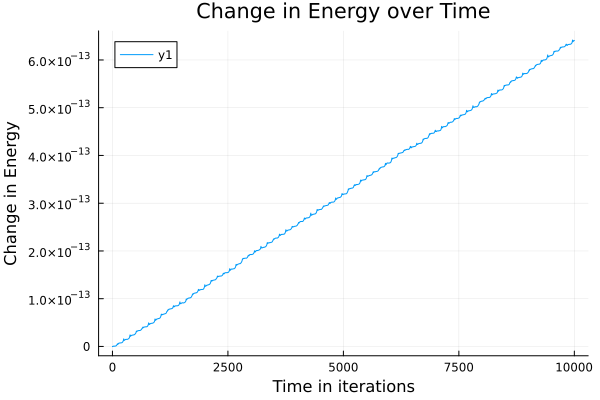

In [82]:
#Plot
Plots.plot(sol.t, [motenergy[i][1] - motenergy[1][1] for i in range(1, length(sol.u))], title="Change in Energy over Time",
    xaxis="Time in iterations", yaxis="Change in Energy")

In [83]:
corbit=map(x->to_cartesian(x),sol.u);

In [84]:
xcorbit= [corbit[i][1] for i in 1:length(corbit)];

In [85]:
# layout = Layout(
#     width=800,
#     height=700,
#     autosize=false,
#     scene=attr(
#         camera=attr(
#             up=attr(x=0, y=0, z=1),
#             eye=attr(x=0, y=1.0707, z=1)
#         ),
#         aspectratio=attr(x=1, y=1, z=0.7),
#         aspectmode="manual",
#     )
# )
# PlotlyJS.plot(PlotlyJS.scatter(
#         x=getindex.(xcorbit, 1),
#         y=getindex.(xcorbit, 2),
#         z=getindex.(xcorbit, 3),
#         marker=attr(size=4, color=getindex.(xcorbit, 3), colorscale="Viridis"),
#         line=attr(color="darkblue", width=2),
#         type="scatter3d",
#         mode="lines+markers"
#     ), layout)

In [86]:
M = 1e0
m = 1e0

S = 1.0 * m * M
E = 0.9328* m
Jz = 2.8 * m * M

r0 = 6.0 * M
theta0 = pi / 2.0
phi0 = 0.0
a0 = 0.8

S1 = 1e-2*m
S2 = 1e-1*m

P1 = 1e-2*m

0.01

In [87]:
gk = cov_metric_tensor(r0, theta0, a0, M)

4×4 Matrix{Float64}:
 -0.666667  0.0       0.0  -0.266667
  0.0       1.46104   0.0   0.0
  0.0       0.0      36.0   0.0
 -0.266667  0.0       0.0  36.8533

In [88]:
gkinv = cot_metric_tensor(r0, theta0, a0, M)

4×4 Matrix{Float64}:
 -1.49567    0.0       0.0        -0.0108225
  0.0        0.684444  0.0         0.0
  0.0        0.0       0.0277778   0.0
 -0.0108225  0.0       0.0         0.0270563

In [89]:
cs = kerr_christoffel(r0, theta0, a0, M);

In [90]:
rllll = kerr_riemann_tensor(r0, theta0, a0, M, "llll")
rulll = kerr_riemann_tensor(r0, theta0, a0, M, "ulll")

4×4×4×4 Array{Float64, 4}:
[:, :, 1, 1] =
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0

[:, :, 2, 1] =
  0.0          -0.0138889    3.16323e-19   0.0
 -0.00641975    0.0          0.0           0.00883951
  7.55955e-21   0.0          0.0          -2.32834e-19
  0.0          -0.000450938  2.29732e-19   0.0

[:, :, 3, 1] =
 0.0          3.60502e-19  0.175556    0.0
 1.86267e-19  0.0          0.0        -2.94302e-18
 0.00333333   0.0          0.0        -0.0100741
 0.0          1.19284e-19  0.0111111   0.0

[:, :, 4, 1] =
 -0.00123457   0.0          0.0          0.170617
  0.0          0.0          2.79401e-18  0.0
  0.0         -1.13393e-19  0.0          0.0
  0.00308642   0.0          0.0          0.00123457

[:, :, 1, 2] =
  0.0          0.0138889    -3.16323e-19   0.0
  0.00641975   0.0           0.0          -0.00883951
 -7.55955e-21  0.0           0.0           2.32834e-19
  0.0          0.000450938  -2.29732e-19   0.0

[:, :, 2, 2] =
 0.0  0.0  0.0

In [91]:
levi = levi_civita_tensor(gk)
#!epsilon^{uuuu}

4×4×4×4 Array{Float64, 4}:
[:, :, 1, 1] =
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0

[:, :, 2, 1] =
 0.0  0.0  0.0         0.0
 0.0  0.0  0.0         0.0
 0.0  0.0  0.0        -0.0277778
 0.0  0.0  0.0277778   0.0

[:, :, 3, 1] =
 0.0   0.0        0.0  0.0
 0.0   0.0        0.0  0.0277778
 0.0   0.0        0.0  0.0
 0.0  -0.0277778  0.0  0.0

[:, :, 4, 1] =
 0.0  0.0         0.0        0.0
 0.0  0.0        -0.0277778  0.0
 0.0  0.0277778   0.0        0.0
 0.0  0.0         0.0        0.0

[:, :, 1, 2] =
 0.0  0.0   0.0        0.0
 0.0  0.0   0.0        0.0
 0.0  0.0   0.0        0.0277778
 0.0  0.0  -0.0277778  0.0

[:, :, 2, 2] =
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0

[:, :, 3, 2] =
 0.0        0.0  0.0  -0.0277778
 0.0        0.0  0.0   0.0
 0.0        0.0  0.0   0.0
 0.0277778  0.0  0.0   0.0

[:, :, 4, 2] =
  0.0        0.0  0.0277778  0.0
  0.0        0.0  0.0        0.0
 -0.0277778  0.0  0.0        0.0

In [92]:
@tullio levi_mixed[p,s,u,v] := levi[p,s,x,y]*gk[x,u]*gk[y,v]

4×4×4×4 Array{Float64, 4}:
[:, :, 1, 1] =
 0.0  0.0          0.0         0.0
 0.0  0.0         -2.3558e-20  0.0
 0.0  2.3558e-20   0.0         0.0
 0.0  0.0          0.0         0.0

[:, :, 2, 1] =
  0.0        0.0   0.0108225  0.0
  0.0        0.0   0.0        0.0
 -0.0108225  0.0   0.0        0.0270563
  0.0        0.0  -0.0270563  0.0

[:, :, 3, 1] =
 0.0       -0.266667  0.0   0.0
 0.266667   0.0       0.0  -0.666667
 0.0        0.0       0.0   0.0
 0.0        0.666667  0.0   0.0

[:, :, 4, 1] =
 0.0   0.0       0.0       0.0
 0.0   0.0       0.684444  0.0
 0.0  -0.684444  0.0       0.0
 0.0   0.0       0.0       0.0

[:, :, 1, 2] =
 0.0        0.0  -0.0108225   0.0
 0.0        0.0   0.0         0.0
 0.0108225  0.0   0.0        -0.0270563
 0.0        0.0   0.0270563   0.0

[:, :, 2, 2] =
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0

[:, :, 3, 2] =
 0.0      0.0  0.0  -1.46104
 0.0      0.0  0.0   0.0
 0.0      0.0  0.0   0.0
 1.46104  0.0  0.0   0

In [93]:
dgkt, dgkp = metric_D(r0, theta0, a0, M)

([0.0 -0.05555555555555555 7.257166217169501e-19 0.0; 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0; 0.0 0.044444444444444446 -3.323782127463632e-17 0.0], [0.0 0.044444444444444446 -3.323782127463632e-17 0.0; 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0; 0.0 11.964444444444446 4.539821927477422e-15 0.0])

In [94]:
@vars p0 p2 p3 s0 s3

(p0, p2, p3, s0, s3)

In [95]:
gpcoordu = [p0, P1, p2, p3]
gscoordu = [s0, S1, S2, s3]

4-element Vector{Basic}:
   s0
 0.01
  0.1
   s3

In [96]:
gpcoordu

4-element Vector{Basic}:
   p0
 0.01
   p2
   p3

In [97]:
# Definitions
Delta = a0^2 - 2 * M * r0 + r0^2
Sigma = r0^2 + a0^2 * cos(theta0)^2


36.0

In [98]:
Suv = spintensor(levi, gpcoordu, gscoordu, gk, m)
#!Config: uu, In tetrad Basis

4×4 Matrix{Basic}:
                                                                                                                                        0  …                                                                                                0.00146103896103896 - 0.0146103896103896*p2
                                -1.0*p2*(-0.266666666666667*s0 + 36.8533333333333*s3) + 0.1*(-0.266666666666667*p0 + 36.8533333333333*p3)                                    1.0*p2*(-0.666666666666667*s0 - 0.266666666666667*s3) - 0.1*(-0.666666666666667*p0 - 0.266666666666667*p3)
 -0.000405844155844156*(-0.266666666666667*p0 + 36.8533333333333*p3) + 0.000405844155844156*(-0.266666666666667*s0 + 36.8533333333333*s3)     0.000405844155844156*(-0.666666666666667*p0 - 0.266666666666667*p3) - 0.000405844155844156*(-0.666666666666667*s0 - 0.266666666666667*s3)
                                                                                             -0.00146103896103896 + 0.0146103896103896*p2    

In [99]:
SymEngine.expand(Suv[3,4])

-0.000270562770562771*p0 - 0.000108225108225108*p3 + 0.000270562770562771*s0 + 0.000108225108225108*s3

In [100]:
eq210a = energy(gk, gpcoordu, Suv, dgkt) - E;

In [101]:
SymEngine.expand(eq210a)

-0.9328 + 0.664444444444445*p0 + 0.368444444444444*p3 + 4.53572888573094e-21*s0 - 3.62858310858475e-21*s3 + 0.0222222222222222*p2*s0 - 1.01777777777778*p2*s3

In [102]:
eq210b = angular_momentum(gk, gpcoordu, Suv, dgkp) - Jz;

In [103]:
SymEngine.expand(eq210b)

-2.8 + 0.131555555555556*p0 + 37.0947555555556*p3 + 6.15951982682262e-19*s0 - 2.90286648686776e-21*s3 - 3.98222222222222*p2*s0 - 2.41422222222222*p2*s3

In [104]:
eq533 = get_norm(gpcoordu, gk)[1] + m^2;

In [105]:
# eq229 = ein"ij,j,i->"(eta, gpi, gsi)[1]

@tullio  eq229[]:=gk[i,j]*gpcoordu[j]*gscoordu[i]
# end
eq229=eq229[1];

In [106]:
# eq228= ein"ij,j,i->"(eta,gsi,gsi)[1]-S^2
# @tensor begin
@tullio eq228[]:=gk[i,j]*gscoordu[j]*gscoordu[i]
# end
eq228=eq228[1]-S^2;

In [107]:
SymEngine.expand(eq210a)

-0.9328 + 0.664444444444445*p0 + 0.368444444444444*p3 + 4.53572888573094e-21*s0 - 3.62858310858475e-21*s3 + 0.0222222222222222*p2*s0 - 1.01777777777778*p2*s3

In [108]:
SymEngine.expand(eq210b)

-2.8 + 0.131555555555556*p0 + 37.0947555555556*p3 + 6.15951982682262e-19*s0 - 2.90286648686776e-21*s3 - 3.98222222222222*p2*s0 - 2.41422222222222*p2*s3

In [109]:
SymEngine.expand(eq533)

1.0001461038961 - 0.533333333333333*p0*p3 - 0.666666666666667*p0^2 + 36.0*p2^2 + 36.8533333333333*p3^2

In [110]:
SymEngine.expand(eq228)

-0.639853896103896 - 0.533333333333333*s0*s3 - 0.666666666666667*s0^2 + 36.8533333333333*s3^2

In [111]:
SymEngine.expand(eq229)

0.000146103896103896 + 3.6*p2 - 0.666666666666667*p0*s0 - 0.266666666666667*p0*s3 - 0.266666666666667*p3*s0 + 36.8533333333333*p3*s3

In [112]:
feq210a=lambdify(eq210a,[p0,p2,p3,s0,s3])

#36 (generic function with 1 method)

In [113]:
feq210b = lambdify(eq210b, [p0, p2, p3, s0, s3])

#36 (generic function with 1 method)

In [114]:
feq228 = lambdify(eq228, [p0, p2, p3, s0, s3])

#36 (generic function with 1 method)

In [115]:
feq229 = lambdify(eq229[1], [p0, p2, p3, s0, s3])

#36 (generic function with 1 method)

In [116]:
feq533 = lambdify(eq533, [p0, p2, p3, s0, s3])

#36 (generic function with 1 method)

In [117]:
function solve_eq(p)
    [feq210a(p[1], p[2], p[3],p[4],p[5]),
        feq210b(p[1], p[2], p[3],p[4],p[5]),
        feq533(p[1], p[2], p[3],p[4],p[5]),
        feq228(p[1], p[2], p[3], p[4], p[5]),
        feq229(p[1], p[2], p[3], p[4], p[5])]

end

solve_eq (generic function with 1 method)

In [118]:
solve_eq([m,m,m,m,m])

5-element Vector{Float64}:
 -0.8954666666666663
 28.029866666666663
 72.65347943722944
 35.01347943722944
 39.253479437229444

In [119]:
root = nlsolve(solve_eq, [1.3, 0.05, 0.07, 0.6, 0.15], ftol=1e-15, iterations=10000000)

Results of Nonlinear Solver Algorithm
 * Algorithm: Trust-region with dogleg and autoscaling
 * Starting Point: [1.3, 0.05, 0.07, 0.6, 0.15]
 * Zero: [1.3747301298986334, 0.0548361781118968, 0.07483561965504106, 0.6209911592264852, 0.16056489276435518]
 * Inf-norm of residuals: 0.000000
 * Iterations: 4
 * Convergence: true
   * |x - x'| < 0.0e+00: false
   * |f(x)| < 1.0e-15: true
 * Function Calls (f): 5
 * Jacobian Calls (df/dx): 5

In [120]:
solve_eq(root.zero)

5-element Vector{Float64}:
 -1.244664094013359e-16
 -3.3306690738754696e-16
  2.220446049250313e-16
 -1.6653345369377348e-16
  0.0

In [121]:
np0,np2,np3,ns0,ns3=root.zero

5-element Vector{Float64}:
 1.3747301298986334
 0.0548361781118968
 0.07483561965504106
 0.6209911592264852
 0.16056489276435518

In [122]:
ngpcoordu=[np0,P1,np2,np3]
ngscoordu = [ns0, S1, S2, ns3]

4-element Vector{Float64}:
 0.6209911592264852
 0.01
 0.1
 0.16056489276435518

In [123]:
get_norm(ngpcoordu,gk)

-0.9999999999999997

In [124]:
get_norm(ngscoordu,gk)

0.9999999999999999

In [125]:
Suv = spintensor(levi, ngpcoordu, ngscoordu, gk, m)

4×4 Matrix{Float64}:
  0.0           0.0762695  -0.0013638     0.000659861
 -0.0762695     0.0        -0.119272      0.0685945
  0.0013638     0.119272    0.0          -0.000194656
 -0.000659861  -0.0685945   0.000194656   0.0

In [126]:
vmu0 = rhs27(ngpcoordu / m, Suv, rllll, m)

4-element Vector{Float64}:
 1.3749141050830986
 0.010041081806717086
 0.0551231484327174
 0.07467051324860047

In [127]:
calculate_four_spin(ngpcoordu, vmu0, ngscoordu, cs, rllll, levi_mixed, m)

4-element Vector{Float64}:
 -0.0006358306352982178
  0.0595615530013553
 -0.0002608778355824248
 -0.0004015260948935656

In [128]:
# rhs23([0.0, r0, theta0, phi0], vmu0, s_coordu, p_coordu,gk, epsl, a0)

In [129]:
y0 = [
    0.0,
    r0,
    theta0,
    phi0,
    ngpcoordu[1],
    ngpcoordu[2],
    ngpcoordu[3],
    ngpcoordu[4],
    ngscoordu[1],
    ngscoordu[2],
    ngscoordu[3],
    ngscoordu[4],
];

In [130]:
y0

12-element Vector{Float64}:
 0.0
 6.0
 1.5707963267948966
 0.0
 1.3747301298986334
 0.01
 0.0548361781118968
 0.07483561965504106
 0.6209911592264852
 0.01
 0.1
 0.16056489276435518

In [131]:
get_constants(y0, gk, a0, M)

(0.9327999999999999, 2.8, -0.9999999999999997, 0.9999999999999999, 3.529278937463638e-17)

In [132]:
p = [a0, m, M]

3-element Vector{Float64}:
 0.8
 1.0
 1.0

In [133]:
t = range(0.,step=1,stop=100000);
t_span = (0, last(t))

(0, 100000.0)

In [134]:
f! = ODEFunction(MPD!);
prob = ODEProblem(MPD!, y0, t_span, p);
saveat=1.0

1.0

In [135]:
# Define the callback function for the Poincaré section
# function poincare_condition(u, t, integrator)
#     # return abs(u[4] % pi - 1)  # Poincaré section at z = 15.0
#     gk=metric_tensor(u[2],u[3],a0,M)
#     velocity=rhs27(u[1:4],u[5:8]./m,u[9:12],gk,epsl,a0,m,"u",M)
#     return velocity[3]-pi/2
# end

# function poincare_callback!(integrator)
#     append!(integrator.u_saved, copy(integrator.u))
# end

In [136]:
# # Define the callback
poincare(u, t, integrator) = u[3]-pi/2 # Trigger when the Third component becomes zero
affect!(integrator) = integrator.u[3] = integrator.u[3]  # Reset the second component to itself
cb = ContinuousCallback(poincare, affect!,save_positions=(true,false),abstol=1e-14,reltol=1e-11);

In [137]:
# Create the callback function
# cb = DiscreteCallback(poincare_condition, poincare_callback!)

In [138]:
saveat=range(start=0.0,stop=100000,step=1)

0.0:1.0:100000.0

In [139]:
c
# sol = solve(prob, alg=TRBDF2(),callback = cb, reltol=1e-11, abstol=1e-11, maxiters=1e6);
# sol = DifferentialEquations.solve(prob, alg=AutoVern7(Rodas5()), reltol=1e-11, abstol=1e-11, maxiters=1e6);

retcode: Success
Interpolation: 1st order linear
t: 101954-element Vector{Float64}:
      0.0
      1.0
      2.0
      3.0
      4.0
      5.0
      6.0
      7.0
      8.0
      9.0
      ⋮
  99992.0
  99993.0
  99994.0
  99995.0
  99996.0
  99997.0
  99998.0
  99999.0
 100000.0
u: 101954-element Vector{Vector{Float64}}:
 [0.0, 6.0, 1.5707963267948966, 0.0, 1.3747301298986334, 0.01, 0.0548361781118968, 0.07483561965504106, 0.6209911592264852, 0.01, 0.1, 0.16056489276435518]
 [1.374351546436986, 6.0106455040012, 1.6257870498016738, 0.07458186161507684, 1.3735781880244626, 0.010828802408851562, 0.054544180613908616, 0.07470591835682973, 0.6185917530110447, 0.06939652114713096, 0.09915780170492583, 0.1601539274801528]
 [2.7473799016595666, 6.022476598206644, 1.6803500471426926, 0.14917635052920736, 1.372177858740322, 0.011640667440107732, 0.054027626105968674, 0.07486228822761355, 0.6127260825399845, 0.12820752310616712, 0.0971739661171975, 0.15971740672273582]
 [4.118801566432034, 6.03

In [140]:
motconst = map(x -> get_constants(x, cov_metric_tensor(x[2], x[3], a0, M), a0, M), sol.u);

In [141]:
diffmotconst= [motconst[i].-[E,Jz,-m^2,S^2,0.0] for i in range(1,length(motconst))];

In [142]:
@show ΔE = diffmotconst[1][1] - diffmotconst[end][1]

ΔE = (diffmotconst[1])[1] - (diffmotconst[end])[1] = -2.466915560717098e-13


-2.466915560717098e-13

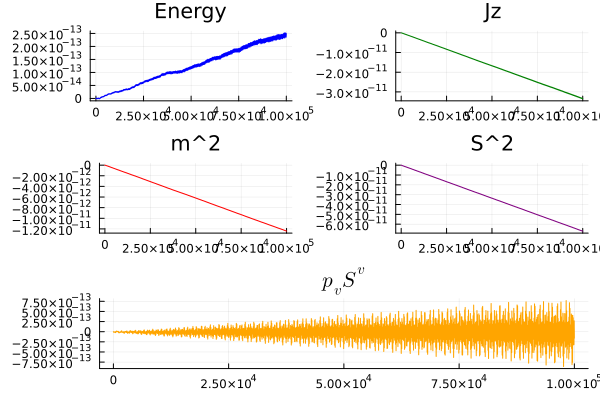

In [143]:
# Create subplots
# Create a 3x2 layout with the specified figsize
plot_layout = @layout [a b; c d; e]
# .plot(layout=plot_layout, size=(1200, 1500), dpi=100)
# Plot data on subplots
plot_array = []

p1=Plots.plot(sol.t, getindex.(diffmotconst,1), label="",title="Energy", color="blue")
p2=Plots.plot(sol.t, getindex.(diffmotconst,2), label="",title="Jz", color="green")
p3=Plots.plot(sol.t, getindex.(diffmotconst,3), label="",title="m^2", color="red")
p4=Plots.plot(sol.t, getindex.(diffmotconst,4), label="",title="S^2", color="purple")
p5=Plots.plot(sol.t, getindex.(diffmotconst,5), label="",title=L"p_v S^v", color="orange")

# Set legends
# for i in 1:3, j in 1:2
#     Plots.plot(legend=:topright)
# end

Plots.plot(p1,p2,p3,p4,p5,layout=plot_layout)
# Remove unused subplot
#  Plots.plot()  # or  nothing

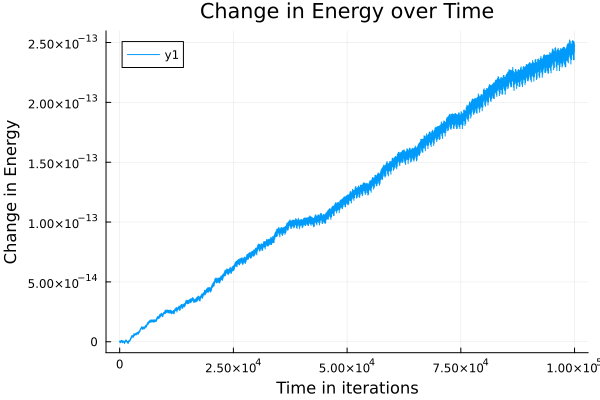

In [144]:
#Plot
Plots.plot(sol.t, getindex.(diffmotconst,1), title="Change in Energy over Time",
    xaxis="Time in iterations", yaxis="Change in Energy")

In [145]:
poi_points = filter(x -> abs(x[3]-pi/2)<1e-13 , sol.u)

1099-element Vector{Vector{Float64}}:
 [0.0, 6.0, 1.5707963267948966, 0.0, 1.3747301298986334, 0.01, 0.0548361781118968, 0.07483561965504106, 0.6209911592264852, 0.01, 0.1, 0.16056489276435518]
 [62.620820905283495, 7.083777913986006, 1.570796326794897, 3.7994638652304356, 1.286358135615998, 0.016449686195407154, -0.03844457360992214, 0.05311054285809854, -0.4868558348689822, 0.18649506781754244, 0.07351567115749566, -0.13137075117881927]
 [133.10366572740156, 6.534352163467171, 1.5707963267948963, 7.53050410736648, 1.3254805581119598, -0.027169684074759535, 0.04117258113575157, 0.06579239203177739, 0.5186061399375567, -0.3392299850054869, 0.06036642729422943, 0.1442088566334572]
 [191.4195815117815, 6.094441797556192, 1.5707963267948968, 11.3909433401318, 1.3629346791175103, 0.016266145965271532, -0.039205278456660095, 0.0808555155867811, -0.4826951810326406, 0.42486108381789806, 0.030882802377123326, -0.15375136247145352]
 [257.86604349520456, 7.210248331806333, 1.5707963267948963, 1

In [146]:
length(poi_points)

1099

In [147]:
vr= zeros(length(poi_points));

In [148]:
for i in range(1,length(vr))
    gkp = cov_metric_tensor(poi_points[i][2], poi_points[i][3], a0, M)
    levip = levi_civita_tensor(gkp)
    Stensorp = spintensor(levip, poi_points[i][5:8], poi_points[i][9:end], gkp, m)
    rllllp = kerr_riemann_tensor(poi_points[i][2], poi_points[i][3], a0, M, "llll")
    vr[i] = rhs27(
        poi_points[i][5:8] / m,
        Stensorp,
        rllllp,
        m,
    )[2]

end

In [149]:
r = [v[2] for v in poi_points];
# vr = [v[6] for v in poi_points];

1099-element Vector{Float64}:
 6.0
 7.083777913986006
 6.534352163467171
 6.094441797556192
 7.210248331806333
 6.301561769770598
 6.51962842671961
 6.91921822659375
 6.027808892068773
 7.099476930093717
 ⋮
 6.172093115611297
 7.178311828687623
 6.822144151723141
 7.228926989529933
 5.999879780204721
 6.844141057647356
 6.812447946008986
 7.240738837040747
 6.642781489712489

In [150]:
corbit=map(x->to_cartesian(x),sol.u);
xcorbit = [corbit[i][1] for i in 1:length(corbit)];

In [151]:
# layout = Layout(
#     width=800,
#     height=700,
#     autosize=false,
#     scene=attr(
#         camera=attr(
#             up=attr(x=0, y=0, z=1),
#             eye=attr(x=0, y=1.0707, z=1)
#         ),
#         aspectratio=attr(x=1, y=1, z=0.7),
#         aspectmode="manual",
#     )
# )
# PlotlyJS.plot(PlotlyJS.scatter(
#         x=getindex.(xcorbit, 1),
#         y=getindex.(xcorbit, 2),
#         z=getindex.(xcorbit, 3),
#         marker=attr(size=4, color=getindex.(xcorbit, 3), colorscale="Viridis"),
#         line=attr(color="darkblue", width=2),
#         type="scatter3d",
#         mode="lines+markers"
#     ), layout)

In [152]:
# PlotlyJS.plot(PlotlyJS.scatter(x=getindex.(poi_points, 2), y=vr, mode="markers"))

In [153]:
theta_poi=[poi_points[i][3] for i in range(1,length(poi_points))];

In [154]:
maximum(theta_poi.-pi/2)

9.992007221626409e-14

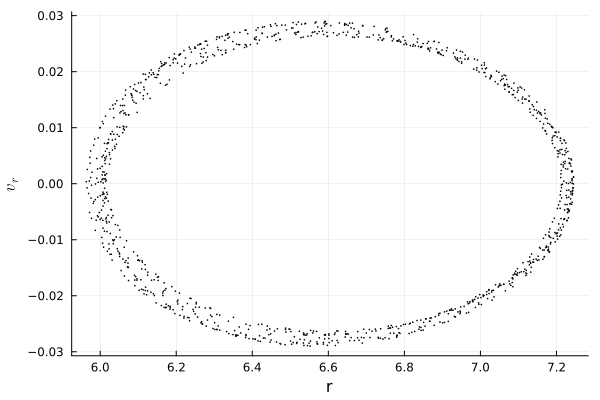

In [155]:
Plots.plot(getindex.(poi_points, 2), vr, seriestype=:scatter, ms=0.5, legend=false)
xlabel!("r")
ylabel!(L"v_r")
# title!(latexstring("\\mathrm{Poincare\\, \\, Plot\\, \\, when\\, theta=pi/2\\, Energy=0.9328e-4, Jz=2.8e-4, S=1e-4}"))
# Plots.savefig("Poincare_Plot_julia.png")
# Add a title with LaTeX
# title!(latexstring("\\mathrm{Poincare\\, \\, Plot\\, \\, when\\, z=0\\, and\\, v_z>0\\,}"))

In [156]:
# stop

In [157]:
@vars dp0,dp3,ds0

(dp0, dp3, ds0)

In [158]:
EPS= 1e-7

1.0e-7

In [159]:
rany0= [0;rand(1);rand(1);rand(1);dp0/EPS;rand(1);rand(1);dp3/EPS;ds0/EPS;rand(1);rand(1);rand(1)].*EPS

12-element Vector{Basic}:
                    0
 2.30030747532428e-08
 5.77433814206281e-08
 7.21969007539547e-08
              1.0*dp0
 6.77426857946105e-08
  9.2041940961172e-08
              1.0*dp3
              1.0*ds0
 2.84350373918026e-08
 4.65350646926377e-08
 3.74720069600875e-08

In [160]:
ry0= y0+rany0

12-element Vector{Basic}:
                            0
             6.00000002300308
             1.57079638453828
         7.21969007539547e-08
   1.37473012989863 + 1.0*dp0
           0.0100000677426858
           0.0548362701538378
 0.0748356196550411 + 1.0*dp3
  0.620991159226485 + 1.0*ds0
           0.0100000284350374
            0.100000046535065
            0.160564930236362

In [161]:
teqC1 = get_norm(y0[5:8], gk) + m^2

3.3306690738754696e-16

In [162]:
eqC1=get_norm(ry0[5:8],gk)+m^2

1.10839870075345 - 0.533333333333333*(1.37473012989863 + 1.0*dp0)*(0.0748356196550411 + 1.0*dp3) + 36.8533333333333*(0.0748356196550411 + 1.0*dp3)^2 - 0.666666666666667*(1.37473012989863 + 1.0*dp0)^2

In [163]:
teqC2 = get_norm(y0[9:end], gk) - S^2

-1.1102230246251565e-16

In [164]:
eqC2= get_norm(ry0[9:end],gk)-S^2

0.310265794652568 - 0.0856346294593932*(0.620991159226485 + 1.0*ds0) - 0.666666666666667*(0.620991159226485 + 1.0*ds0)^2

In [165]:
tps = y0[5:8]
tsu = y0[9:end]
@tullio teqC3 := gk[a, b] * tps[b] * tsu[a]

3.529278937463638e-17

In [166]:
tps= ry0[5:8]
tsu= ry0[9:end]
@tullio eqC3 := gk[a,b]*tps[b]*tsu[a]

0.197556769720254 - 0.266666666666667*(0.620991159226485 + 1.0*ds0)*(0.0748356196550411 + 1.0*dp3) - 0.666666666666667*(1.37473012989863 + 1.0*dp0)*(0.620991159226485 + 1.0*ds0) + 5.91735289564407*(0.0748356196550411 + 1.0*dp3) - 0.0428173147296966*(1.37473012989863 + 1.0*dp0)

In [167]:
feqC1= lambdify(eqC1,[dp0,dp3,ds0])
feqC2 = lambdify(eqC2, [dp0, dp3, ds0])
feqC3 = lambdify(eqC3, [dp0, dp3, ds0])

#36 (generic function with 1 method)

In [168]:
function const_sol_eq(p)
    (feqC1(p[1],p[2],p[3]),feqC2(p[1],p[2],p[3]),feqC3(p[1],p[2],p[3]))
end

const_sol_eq (generic function with 1 method)

In [169]:
u0=[EPS,EPS,EPS]

3-element Vector{Float64}:
 1.0e-7
 1.0e-7
 1.0e-7

In [170]:
const_sol_eq(u0)

(6.563614809440566e-7, 6.755807219760435e-7, 9.500799880157729e-7)

In [171]:
const_sol= nlsolve(const_sol_eq,u0,ftol=1e-15,iterations=1000000)

Results of Nonlinear Solver Algorithm
 * Algorithm: Trust-region with dogleg and autoscaling
 * Starting Point: [1.0e-7, 1.0e-7, 1.0e-7]
 * Zero: [3.961350423283988e-7, 7.872870586254145e-8, 8.394520231098111e-7]
 * Inf-norm of residuals: 0.000000
 * Iterations: 3
 * Convergence: true
   * |x - x'| < 0.0e+00: false
   * |f(x)| < 1.0e-15: true
 * Function Calls (f): 4
 * Jacobian Calls (df/dx): 4

In [172]:
const_sol.zero

3-element Vector{Float64}:
 3.961350423283988e-7
 7.872870586254145e-8
 8.394520231098111e-7

In [173]:
ndp0,ndp3,nds0= const_sol.zero

3-element Vector{Float64}:
 3.961350423283988e-7
 7.872870586254145e-8
 8.394520231098111e-7

In [174]:
rany0[5]= ndp0
rany0[8]= ndp3
rany0[9]= nds0

8.394520231098111e-7

In [175]:
rany0

12-element Vector{Basic}:
                    0
 2.30030747532428e-08
 5.77433814206281e-08
 7.21969007539547e-08
 3.96135042328399e-07
 6.77426857946105e-08
  9.2041940961172e-08
 7.87287058625415e-08
 8.39452023109811e-07
 2.84350373918026e-08
 4.65350646926377e-08
 3.74720069600875e-08

In [176]:
ry0= y0+ rany0

12-element Vector{Basic}:
                    0
     6.00000002300308
     1.57079638453828
 7.21969007539547e-08
     1.37473052603368
   0.0100000677426858
   0.0548362701538378
   0.0748356983837469
    0.620991998678508
   0.0100000284350374
    0.100000046535065
    0.160564930236362

In [177]:
dy0= ry0- y0

12-element Vector{Basic}:
                    0
 2.30030750003607e-08
 5.77433814097361e-08
 7.21969007539547e-08
 3.96135042324275e-07
 6.77426857942365e-08
 9.20419409577988e-08
 7.87287058601205e-08
 8.39452023115861e-07
 2.84350373924019e-08
 4.65350646905449e-08
 3.74720069695744e-08

In [178]:
dy0 = [0.0,
    2.924749420429862e-08,
    4.599589487064293e-08,
    4.421523265860271e-08,
    2.9077278651534755e-07,
    8.881229619957243e-08,
    1.7819785987083225e-08,
    9.86123132179495e-08,
    6.904427168885618e-07,
    6.656431269028151e-09,
    3.259041936320983e-08,
    3.442071358494836e-08]

12-element Vector{Float64}:
 0.0
 2.924749420429862e-8
 4.599589487064293e-8
 4.421523265860271e-8
 2.9077278651534755e-7
 8.881229619957243e-8
 1.7819785987083225e-8
 9.86123132179495e-8
 6.904427168885618e-7
 6.656431269028151e-9
 3.259041936320983e-8
 3.442071358494836e-8

In [179]:
EPS = eps()
H = diagm(ones(12) * EPS * im);

In [180]:
function fjac(x, p,t)
    x = Complex.(x)  # Convert x to complex type
    n = 12
    J = zeros(Float64, n, n)  # Initialize J with complex zeros

    for i in 1:n
        J[:, i] = imag(mpdjac(x .+ H[i,:], p,t)) / imag(H[i,i])
    end

    return transpose(J)
end


fjac (generic function with 1 method)

In [181]:
function solve_combined(y, p,t)
    dy= zeros(12)
    MPD!(dy, y[1:12], p,t)
    jac = fjac(y[1:12], p,t)

    dY = y[13:end]

    dY_dt = jac * dY

    dydtf = vec(dY_dt)

    du_ = zeros(24)

    du_[1:12] .= dy
    du_[13:end] .= dydtf

    return du_
end

solve_combined (generic function with 1 method)

In [182]:
w0= dy0;
w0= w0/norm(w0)
w0= Float64.(w0)

12-element Vector{Float64}:
 0.0
 0.03819347515854823
 0.06006473771277476
 0.05773942131177765
 0.3797119548423925
 0.11597746476939054
 0.02327035433101406
 0.1287750297139362
 0.901629608734415
 0.008692445258467471
 0.042558906539503796
 0.04494903597768762

In [183]:
ics0= collect(Iterators.flatten([y0,w0]))

24-element Vector{Float64}:
 0.0
 6.0
 1.5707963267948966
 0.0
 1.3747301298986334
 0.01
 0.0548361781118968
 0.07483561965504106
 0.6209911592264852
 0.01
 ⋮
 0.05773942131177765
 0.3797119548423925
 0.11597746476939054
 0.02327035433101406
 0.1287750297139362
 0.901629608734415
 0.008692445258467471
 0.042558906539503796
 0.04494903597768762

In [184]:
solve_combined(ics0,p,0)

24-element Vector{Float64}:
  1.3749141050830986
  0.010041081806717086
  0.0551231484327174
  0.07467051324860047
 -0.0010236074567731923
  0.0008403020484100028
 -0.00017841256728538194
 -0.0002738712742255292
 -0.0006358306352982178
  0.0595615530013553
  ⋮
  0.0
 -0.006920948828233114
 -0.012631463796411703
  0.10639063485437045
  0.1470668882435269
 -0.0004668273306302354
 -0.05198304966938136
  0.004570673368134512
  0.00025342393472944

In [185]:
tau = 100 * M  # Renormalization time
tf = 10000.0  # Final time
steps = 100

100

In [186]:
function evolve_lyap(ics0,tau,tf,steps,p)

    ti = 0.0
    timestep = range(ti, tf, step=tau) |> collect

    size = length(timestep)
    X1t = zeros(size - 1)
    sum = 0.0
    ics = copy(ics0)

    sol = zeros((size, 12))
    
    sol[1,:]= ics[1:12]

    for i in 1:size-1
        

        t = LinRange(timestep[i], timestep[i+1], steps)
        t_span = (t[1], t[end])

        f! = ODEFunction(solve_combined)
        prob = ODEProblem(solve_combined, ics, t_span, p)

        usol = DifferentialEquations.solve(prob, alg=AutoVern7(Rodas5()), saveat=t, reltol=1e-12, abstol=1e-12, maxiters=1e6)
        usol = usol.u[end]

        xk = usol[1:12]
        wk = usol[13:end]

        alphak = norm(wk)
        sum = sum + log(alphak)
        X1t[i] = sum / timestep[i+1]
        wk0 = wk / alphak

        ics[1:12] = xk
        ics[13:end] = wk0

        sol[i+1, :] = ics[1:12]
        

    end

    return X1t

end

evolve_lyap (generic function with 1 method)

In [187]:
lyaps= evolve_lyap(ics0,tau,tf,steps,p)

100-element Vector{Float64}:
 0.07352702065214747
 0.0664519363938726
 0.05132457279267308
 0.048449159305982634
 0.04518233774751191
 0.04569357323900859
 0.04690441021338998
 0.04958880332157028
 0.05065114642432583
 0.0472076431499343
 ⋮
 0.047908147572422954
 0.047697923464118094
 0.047792110714328644
 0.047929919907709395
 0.04810242897506568
 0.048001740157515356
 0.04785773224496409
 0.047904380887971915
 0.04798523629749959

In [191]:
Statistics.mean(lyaps)

0.048324063516632106

In [189]:
1/(18*M)

0.05555555555555555

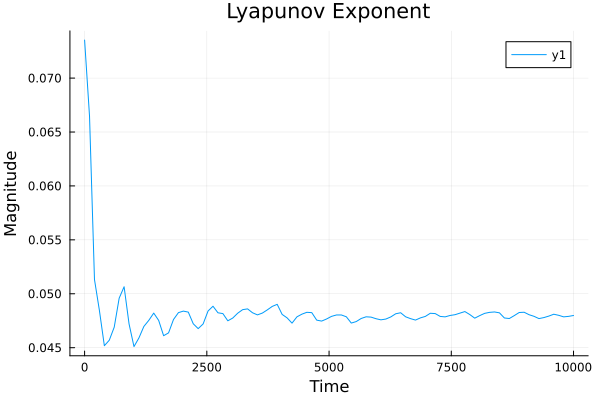

In [192]:
Plots.plot(LinRange(0.0, tf, length(lyaps))[1:end], lyaps, title="Lyapunov Exponent",
    xaxis="Time", yaxis="Magnitude")